In [11]:
from astropy.modeling import models, fitting
from dendrocat import RadioSource
from astropy.io import fits
from spectral_cube import SpectralCube
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import numpy as np
import sys
import importlib
from astropy.wcs import WCS
from scipy import interpolate
import pandas as pd
import sympy as syp
from astropy import units as u
import radio_beam
from astropy.table import Table
from radio_beam import Beam
from astropy import coordinates
from astropy import wcs
from astropy.nddata.utils import Cutout2D
#from dendrocat.aperture import Ellipse
from matplotlib.patches import Rectangle, Ellipse
import regions
from scipy.optimize import curve_fit
from regions import EllipseAnnulusSkyRegion, EllipseAnnulusPixelRegion
import Paths.Paths as paths
Path = paths.filepaths()






isincore_w51e_b3 40
isoutcore_w51e_b3 75
iscore_ff_w51e 13
isincore_w51n_b3 47
isoutcore_w51n_b3 17
iscore_ff_w51n 10
0 2.9662504711543445
1 2.343162422319542
2 2.455068906940818
3 3.2647279734542165
4 2.8344820571898253
5 2.513789803480504
6 2.5039644895460094
7 0.7080809297085597
8 2.1869600347406797
9 2.3076689286018426
10 2.2714731737307905
11 2.7005611574411374
12 1.873164702667606
13 2.204894319749008
14 2.8217033274292507
15 2.3779399907960115
16 2.6789259567197408
17 2.252074200703885
18 3.267277897515499
19 2.3311897502499015
20 2.0998694966581515
21 2.7086387185923106
22 2.7622667103302216
23 1.9793401740033931
24 2.4031784741571878
25 1.8725723019080176
26 2.9739154186846366
27 2.5274997348411734
28 1.8815560791323747
29 1.0879524030617733
30 2.9961954391458345
31 2.5207553762468105
32 2.8357878766163314
33 1.3873176100550286
34 2.021291174003346
35 2.412798212009318
36 2.823310763423824
37 1.895711800922134
38 2.829122841599939
39 2.66683704539366
40 1.6787626767847086
41 -

"\nax1.vlines(w51e_b6_min_size,0,1,color='cyan',lw=2,ls='dashed')\nax1.vlines(w51e_b3_min_size,0,1,color='peru',lw=2,ls='dashed')\nax1.vlines(w51n_b6_min_size,0,1,color='b',lw=2,ls='dashed')\nax1.vlines(w51n_b3_min_size,0,1,color='orange',lw=2,ls='dashed')\n"

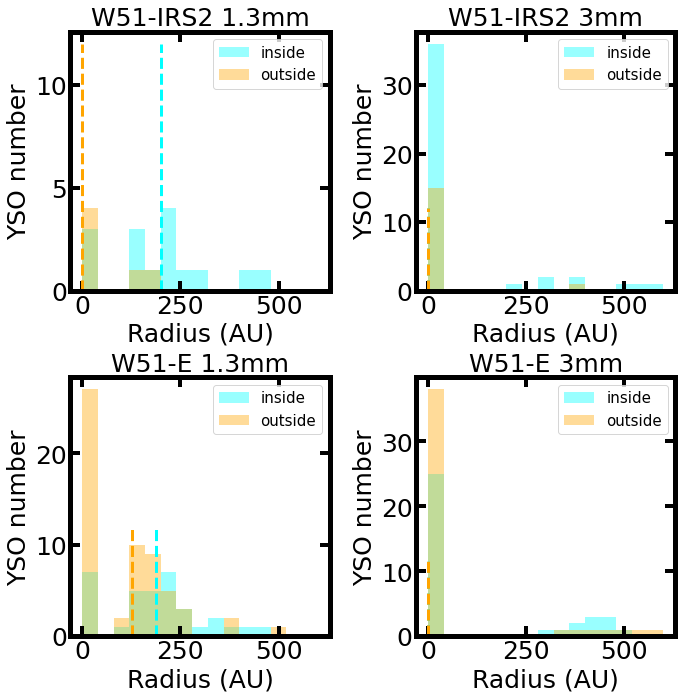

In [12]:
from astropy.table import Table
import matplotlib as mpl
import astropy.units as u
import astropy.constants as c
from lifelines import KaplanMeierFitter

plt.rcParams['axes.labelsize']=25
plt.rcParams['xtick.labelsize']=25
plt.rcParams['ytick.labelsize']=25
plt.rcParams['axes.titlesize']=25
mpl.rcParams['axes.linewidth'] = 5
mpl.rcParams['xtick.major.size'] = 10
mpl.rcParams['xtick.major.width'] = 4
mpl.rcParams['xtick.minor.size'] = 5
mpl.rcParams['xtick.minor.width'] = 2
mpl.rcParams['ytick.major.size'] = 10
mpl.rcParams['ytick.major.width'] = 4
mpl.rcParams['ytick.minor.size'] = 5
mpl.rcParams['ytick.minor.width'] = 2
params = {"xtick.top": True, "ytick.right": True, "xtick.direction": "in", "ytick.direction": "in"}
plt.rcParams.update(params)


w51e_b3_flux_fits = Table.read(Path.w51e_b3_flux)
w51e_b6_flux_fits = Table.read(Path.w51e_b6_flux)
w51n_b3_flux_fits = Table.read(Path.w51n_b3_flux)
w51n_b6_flux_fits = Table.read(Path.w51n_b6_flux)
w51e_b6_flux_conv_fits = Table.read(Path.w51e_b6_conv_flux)
w51n_b6_flux_conv_fits = Table.read(Path.w51n_b6_conv_flux)

def get_max_size(size_major, size_minor):
    sizearr = []
    idxarr = []
    for i in range(len(size_major)):
        if size_major[i]>size_minor[i]:
            sizearr.append(size_major[i])
        else:
            sizearr.append(size_minor[i])
            idxarr.append(i)
    return np.array(sizearr), np.array(idxarr)

def get_radius(fitsfile, band='b6', index=None, dist_kpc = 5.41):
 
    fits = Table.read(fitsfile)
    major = fits['deconvolved_major_%s'%band]
    minor = fits['deconvolved_minor_%s'%band]
    if index is None:
        index = np.arange(len(major))
    
    avg_size = np.sqrt(major * minor)[index]
    avg_size = np.max((major[index],minor[index]))
    radius_au = avg_size * np.pi/180 * dist_kpc *1000*206264.806 *2/2.355
    return radius_au
def print_idx_value_in_loop(idx, value,label):
    print(label)
    for id, val in zip((idx, value)):
        print(id, val)

catalog_w51e_yso = Table.read(Path.w51e_dendro_matched_catalog,format='fits')
w51e_selected = np.delete(np.arange(137),[121,125,126,130,131,132,134,135,136]) #delete overlapped objects


yso_w51e_xsky_b6 = catalog_w51e_yso['b6_xsky'] ; yso_w51e_ysky_b6 = catalog_w51e_yso['b6_ysky']
yso_w51e_xsky_b3 = catalog_w51e_yso['b3_xsky'] ; yso_w51e_ysky_b3 = catalog_w51e_yso['b3_ysky']

yso_detect_w51e_b6 = np.where(yso_w51e_xsky_b6>0)[0]
yso_detect_w51e_b3 = np.where(yso_w51e_xsky_b3>0)[0]


catalog_w51n_yso = Table.read(Path.w51n_dendro_matched_catalog ,format='fits')
yso_w51n_xsky_b6 = catalog_w51n_yso['b6_xsky'] ; yso_w51n_ysky_b6 = catalog_w51n_yso['b6_ysky']
yso_w51n_xsky_b3 = catalog_w51n_yso['b3_xsky'] ; yso_w51n_ysky_b3 = catalog_w51n_yso['b3_ysky']

yso_xsky_w51e = []
for i,x in enumerate(yso_w51e_xsky_b6):
    if x > 0:
        yso_xsky_w51e.append(x)
    else:
        yso_xsky_w51e.append(yso_w51e_xsky_b3[i])
yso_ysky_w51e = []
for i,x in enumerate(yso_w51e_ysky_b6):
    if x > 0:
        yso_ysky_w51e.append(x)
    else:
        yso_ysky_w51e.append(yso_w51e_ysky_b3[i])

yso_xsky_w51n = []
for i,x in enumerate(yso_w51n_xsky_b6):
    if x > 0:
        yso_xsky_w51n.append(x)
    else:
        yso_xsky_w51n.append(yso_w51n_xsky_b3[i])
yso_ysky_w51n = []
for i,x in enumerate(yso_w51n_ysky_b6):
    if x > 0:
        yso_ysky_w51n.append(x)
    else:
        yso_ysky_w51n.append(yso_w51n_ysky_b3[i])

yso_xysource_w51e= np.vstack((yso_xsky_w51e, yso_ysky_w51e)).T
yso_xysource_w51n= np.vstack((yso_xsky_w51n, yso_ysky_w51n)).T        

#YSO index for indicating whether they are inside core boundary or not
isincore_w51e_b3 = catalog_w51e_yso['inincore_b3fov'] 
isincore_w51n_b3 = catalog_w51n_yso['inincore_b3fov'] 
isoutcore_w51e_b3 = np.where(~catalog_w51e_yso['inincore_b3fov'])[0] 
isoutcore_w51n_b3 = np.where(~catalog_w51n_yso['inincore_b3fov'])[0] 


# For b6, need to combine isincore index with isoverlap index
isincore_w51e_b6 = np.intersect1d(np.where(catalog_w51e_yso['inincore_b3fov']), np.where(catalog_w51e_yso['is_overlap'])) 
isincore_w51n_b6 = np.intersect1d(np.where(catalog_w51n_yso['inincore_b3fov']), np.where(catalog_w51n_yso['is_overlap'])) 
isoutcore_w51e_b6 = np.intersect1d(np.where(~catalog_w51e_yso['inincore_b3fov']), np.where(catalog_w51e_yso['is_overlap'])) 
isoutcore_w51n_b6 = np.intersect1d(np.where(~catalog_w51n_yso['inincore_b3fov']), np.where(catalog_w51n_yso['is_overlap'])) 

iscore_ff_w51e = [41, 46, 48, 50, 51, 54, 56, 8, 9, 10, 85, 119, 25]
iscore_ff_w51n = [61, 3, 6, 7, 23, 29, 70, 71, 72, 52]



isoutcore_w51e_b3 = [i for i in list(isoutcore_w51e_b3) if i not in iscore_ff_w51e]
isoutcore_w51n_b3 = [i for i in list(isoutcore_w51n_b3) if i not in iscore_ff_w51n]
isoutcore_w51e_b6 = [i for i in list(isoutcore_w51e_b6) if i not in iscore_ff_w51e]
isoutcore_w51n_b6 = [i for i in list(isoutcore_w51n_b6) if i not in iscore_ff_w51n]

print('isincore_w51e_b3', len(np.where(isincore_w51e_b3)[0]))
print('isoutcore_w51e_b3', len(isoutcore_w51e_b3))
print('iscore_ff_w51e', len(iscore_ff_w51e))
print('isincore_w51n_b3', len(np.where(isincore_w51n_b3)[0]))
print('isoutcore_w51n_b3', len(isoutcore_w51n_b3))
print('iscore_ff_w51n', len(iscore_ff_w51n))

si_w51e = catalog_w51e_yso['alpha']
for i in range(len(si_w51e)):
    print(i, si_w51e[i])

si_w51n = catalog_w51n_yso['alpha']


w51e_b3_major = w51e_b3_flux_fits['deconvolved_major']
w51e_b6_major = w51e_b6_flux_fits['deconvolved_major']
w51n_b3_major = w51n_b3_flux_fits['deconvolved_major']
w51n_b6_major = w51n_b6_flux_fits['deconvolved_major']
w51e_b3_minor = w51e_b3_flux_fits['deconvolved_minor']
w51e_b6_minor = w51e_b6_flux_fits['deconvolved_minor']
w51n_b3_minor = w51n_b3_flux_fits['deconvolved_minor']
w51n_b6_minor = w51n_b6_flux_fits['deconvolved_minor']

isoverlap_w51e = catalog_w51e_yso['is_overlap']
isoverlap_w51n = catalog_w51n_yso['is_overlap']

fig = plt.figure(figsize=(12,12))
ax1 = fig.add_axes([0.1,0.1,0.3,0.3])
ax2 = fig.add_axes([0.5,0.1,0.3,0.3])
ax3 = fig.add_axes([0.1,0.5,0.3,0.3])
ax4 = fig.add_axes([0.5,0.5,0.3,0.3])


w51e_b3_max_size,w51e_b3_idx = get_max_size(w51e_b3_major, w51e_b3_minor)
w51e_b6_max_size,w51e_b6_idx = get_max_size(w51e_b6_major[isoverlap_w51e], w51e_b6_major[isoverlap_w51e]) 
w51n_b3_max_size,w51n_b3_idx = get_max_size(w51n_b3_major, w51n_b3_minor)
w51n_b6_max_size,w51n_b6_idx = get_max_size(w51n_b6_major[isoverlap_w51n], w51n_b6_minor[isoverlap_w51n])

w51e_b3_max_size_au = w51e_b3_max_size * np.pi/180 * 5.41*1000*206265 *2/2.355
w51e_b6_max_size_au = w51e_b6_max_size * np.pi/180 * 5.41*1000*206265*2/2.355
w51n_b3_max_size_au = w51n_b3_max_size * np.pi/180 * 5.1*1000*206265*2/2.355
w51n_b6_max_size_au = w51n_b6_max_size * np.pi/180 * 5.1*1000*206265*2/2.355
print('ho')
#print(w51e_b3_max_size_au)
print(np.nanmax(w51e_b6_max_size_au))
#print(w51n_b3_max_size_au)
print(np.nanmax(w51n_b6_max_size_au))

w51e_b6_rad_isincore = w51e_b6_max_size_au[isincore_w51e_b6]
w51e_b6_rad_isoutcore = w51e_b6_max_size_au[isoutcore_w51e_b6]

w51e_b3_rad_isincore = w51e_b3_max_size_au[isincore_w51e_b3]
w51e_b3_rad_isoutcore = w51e_b3_max_size_au[isoutcore_w51e_b3]

w51n_b6_rad_isincore = w51n_b6_max_size_au[isincore_w51n_b6]
w51n_b6_rad_isoutcore = w51n_b6_max_size_au[isoutcore_w51n_b6]

w51n_b3_rad_isincore = w51n_b3_max_size_au[isincore_w51n_b3]
w51n_b3_rad_isoutcore = w51n_b3_max_size_au[isoutcore_w51n_b3]
print(np.nanmax(w51e_b6_rad_isincore))
print(np.nanmax(w51e_b6_rad_isoutcore))
print(np.nanmax(w51n_b6_rad_isincore))
print(np.nanmax(w51n_b6_rad_isoutcore))
#w51e_b6_rad[~w51e_b6_unresolved] = w51e_b6_min_size*2/2.355
#w51e_b3_rad[~w51e_b3_unresolved] = w51e_b3_min_size*2/2.355
#w51n_b6_rad[~w51n_b6_unresolved] = w51n_b6_min_size*2/2.355
#w51n_b3_rad[~w51n_b3_unresolved] = w51n_b3_min_size*2/2.355

bins = np.linspace(0,600,16)


ax1.hist(w51e_b6_rad_isincore, bins=bins, label='inside', color='cyan', alpha=0.4)
ax1.hist(w51e_b6_rad_isoutcore, bins=bins, label='outside', color='orange', alpha=0.4)
ax1.vlines(np.median(w51e_b6_rad_isincore[w51e_b6_rad_isincore<1e5]),0,12, color='cyan',lw=3, ls='dashed')
ax1.vlines(np.median(w51e_b6_rad_isoutcore[w51e_b6_rad_isoutcore<1e5]),0,12, color='orange',lw=3, ls='dashed')

ax1.set_title('W51-E 1.3mm')
ax1.set_xlabel('Radius (AU)')
ax1.set_ylabel('YSO number')
ax1.legend(fontsize=15)

ax2.hist(w51e_b3_rad_isincore, bins=bins, label='inside', color='cyan', alpha=0.4)
ax2.hist(w51e_b3_rad_isoutcore, bins=bins, label='outside', color='orange', alpha=0.4)
ax2.vlines(np.median(w51e_b3_rad_isincore[w51e_b3_rad_isincore<1e5]),0,12, color='cyan',lw=3, ls='dashed')
ax2.vlines(np.median(w51e_b3_rad_isoutcore[w51e_b3_rad_isoutcore<1e5]),0,12, color='orange',lw=3, ls='dashed')
ax2.set_title('W51-E 3mm')
ax2.set_xlabel('Radius (AU)')
ax2.set_ylabel('YSO number')
ax2.legend(fontsize=15)

ax3.hist(w51n_b6_rad_isincore, bins=bins, label='inside', color='cyan', alpha=0.4)
ax3.hist(w51n_b6_rad_isoutcore, bins=bins, label='outside', color='orange', alpha=0.4)
ax3.vlines(np.median(w51n_b6_rad_isincore[w51n_b6_rad_isincore<1e5]),0,12, color='cyan',lw=3, ls='dashed')
ax3.vlines(np.median(w51n_b6_rad_isoutcore[w51n_b6_rad_isoutcore<1e5]),0,12, color='orange',lw=3, ls='dashed')
ax3.set_title('W51-IRS2 1.3mm')
ax3.set_xlabel('Radius (AU)')
ax3.set_ylabel('YSO number')
ax3.legend(fontsize=15)

ax4.hist(w51n_b3_rad_isincore, bins=bins, label='inside', color='cyan', alpha=0.4)
ax4.hist(w51n_b3_rad_isoutcore, bins=bins, label='outside', color='orange', alpha=0.4)
ax4.vlines(np.median(w51n_b3_rad_isincore[w51n_b3_rad_isincore<1e5]),0,12, color='cyan',lw=3, ls='dashed')
ax4.vlines(np.median(w51n_b3_rad_isoutcore[w51n_b3_rad_isoutcore<1e5]),0,12, color='orange',lw=3, ls='dashed')
ax4.set_title('W51-IRS2 3mm')
ax4.set_xlabel('Radius (AU)')
ax4.set_ylabel('YSO number')
ax4.legend(fontsize=15)


"""
ax1.vlines(w51e_b6_min_size,0,1,color='cyan',lw=2,ls='dashed')
ax1.vlines(w51e_b3_min_size,0,1,color='peru',lw=2,ls='dashed')
ax1.vlines(w51n_b6_min_size,0,1,color='b',lw=2,ls='dashed')
ax1.vlines(w51n_b3_min_size,0,1,color='orange',lw=2,ls='dashed')
"""




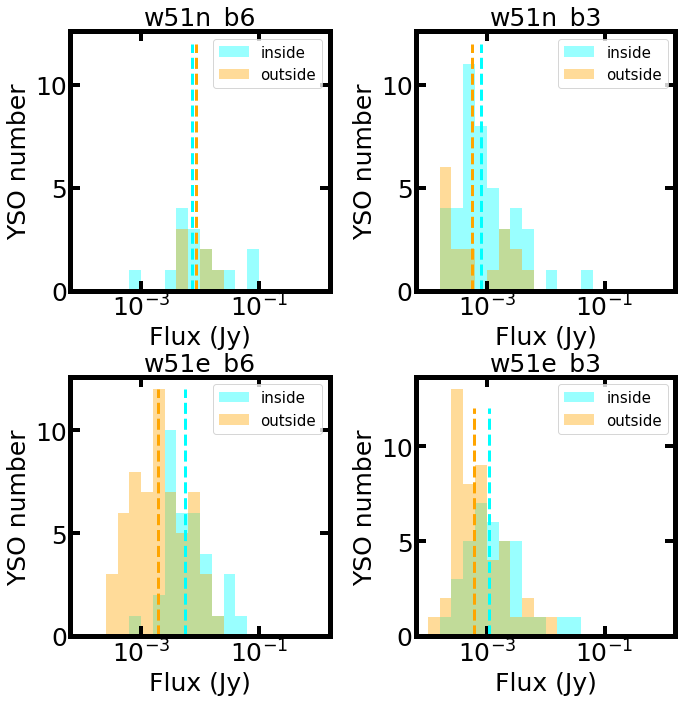

In [13]:
def kappa(nu, nu0=271.1*u.GHz, kappa0=0.0114*u.cm**2*u.g**-1, beta=1.75):
    """
    Compute the opacity $\kappa$ given a reference frequency (or wavelength)
    and a power law governing the opacity as a fuction of frequency:
    $$ \kappa = \kappa_0 \left(\\frac{\\nu}{\\nu_0}\\right)^{\\beta} $$
    The default kappa=0.0114 at 271.1 GHz comes from extrapolating the
    Ossenkopf & Henning 1994 opacities for the thin-ice-mantle, 10^6 year model
    anchored at 1.0 mm with an assumed beta of 1.75.
    Parameters
    ----------
    nu: astropy.Quantity [u.spectral() equivalent]
        The frequency at which to evaluate kappa
    nu0: astropy.Quantity [u.spectral() equivalent]
        The reference frequency at which $\kappa$ is defined
    kappa0: astropy.Quantity [cm^2/g]
        The dust opacity per gram of H2 along the line of sight.  Because of
        the H2 conversion, this factor implicitly includes a dust to gas ratio
        (usually assumed 100)
    beta: float
        The power-law index governing kappa as a function of nu
    """
    return (kappa0*(nu.to(u.GHz,u.spectral())/nu0.to(u.GHz,u.spectral()))**(beta)).to(u.cm**2/u.g)
def get_mass(flux, kappa, freq, temp=50*u.K, dist=5.41*u.kpc, verbose=False):
    BB = 2 *np.pi * c.h * freq**3 / (c.c**2) / (np.e**(c.h*freq/(c.k_B*temp)) - 1)
    mass = flux.to(u.Jy) * dist**2 / BB.to(u.Jy) / kappa
    
    return mass.to(u.Msun)

fig = plt.figure(figsize=(12,12))
ax1 = fig.add_axes([0.1,0.1,0.3,0.3])
ax2 = fig.add_axes([0.5,0.1,0.3,0.3])
ax3 = fig.add_axes([0.1,0.5,0.3,0.3])
ax4 = fig.add_axes([0.5,0.5,0.3,0.3])


ysoflux_b6_w51e = w51e_b6_flux_fits['flux']
ysoflux_b3_w51e = w51e_b3_flux_fits['flux']
ysoflux_b6_w51n = w51n_b6_flux_fits['flux']
ysoflux_b3_w51n = w51n_b3_flux_fits['flux']

w51e_b6_flux_isincore = w51e_b6_flux_fits['flux'][isincore_w51e_b6] 
w51e_b6_flux_isoutcore = w51e_b6_flux_fits['flux'][isoutcore_w51e_b6]
w51e_b6_flux_isffcore = w51e_b6_flux_fits['flux'][iscore_ff_w51e] 

w51e_b3_flux_isincore = w51e_b3_flux_fits['flux'][isincore_w51e_b3] 
w51e_b3_flux_isoutcore = w51e_b3_flux_fits['flux'][isoutcore_w51e_b3] 
w51e_b3_flux_isffcore = w51e_b3_flux_fits['flux'][iscore_ff_w51e]

w51n_b6_flux_isincore = w51n_b6_flux_fits['flux'][isincore_w51n_b6] 
w51n_b6_flux_isoutcore = w51n_b6_flux_fits['flux'][isoutcore_w51n_b6] 
w51n_b6_flux_isffcore = w51n_b6_flux_fits['flux'][iscore_ff_w51n]

w51n_b3_flux_isincore = ysoflux_b3_w51n[isincore_w51n_b3] 
w51n_b3_flux_isoutcore = ysoflux_b3_w51n[isoutcore_w51n_b3] 
w51n_b3_flux_isffcore = ysoflux_b3_w51n[iscore_ff_w51n]


bins = np.logspace(-4,0,21)



ax1.hist(w51e_b6_flux_isincore[w51e_b6_flux_isincore>0], bins=bins, label='inside', color='cyan', alpha=0.4)
ax1.hist(w51e_b6_flux_isoutcore[w51e_b6_flux_isoutcore>0], bins=bins, label='outside', color='orange', alpha=0.4)
ax1.vlines(np.median(w51e_b6_flux_isincore[w51e_b6_flux_isincore>0]),0,12, color='cyan',lw=3, ls='dashed')
ax1.vlines(np.median(w51e_b6_flux_isoutcore[w51e_b6_flux_isoutcore>0]),0,12, color='orange',lw=3, ls='dashed')

ax1.set_title('w51e_b6')
ax1.set_xlabel('Flux (Jy)')
ax1.set_ylabel('YSO number')
ax1.legend(fontsize=15)
ax1.set_xscale('log')

ax2.hist(w51e_b3_flux_isincore[w51e_b3_flux_isincore>0], bins=bins, label='inside', color='cyan', alpha=0.4)
ax2.hist(w51e_b3_flux_isoutcore[w51e_b3_flux_isoutcore>0], bins=bins, label='outside', color='orange', alpha=0.4)
ax2.vlines(np.median(w51e_b3_flux_isincore[w51e_b3_flux_isincore>0]),0,12, color='cyan',lw=3, ls='dashed')
ax2.vlines(np.median(w51e_b3_flux_isoutcore[w51e_b3_flux_isoutcore>0]),0,12, color='orange',lw=3, ls='dashed')
ax2.set_title('w51e_b3')
ax2.set_xlabel('Flux (Jy)')
ax2.set_ylabel('YSO number')
ax2.legend(fontsize=15)
ax2.set_xscale('log')

ax3.hist(w51n_b6_flux_isincore[w51n_b6_flux_isincore>0], bins=bins, label='inside', color='cyan', alpha=0.4)
ax3.hist(w51n_b6_flux_isoutcore[w51n_b6_flux_isoutcore>0], bins=bins, label='outside', color='orange', alpha=0.4)
ax3.vlines(np.median(w51n_b6_flux_isincore[w51n_b6_flux_isincore>0]),0,12, color='cyan',lw=3, ls='dashed')
ax3.vlines(np.median(w51n_b6_flux_isoutcore[w51n_b6_flux_isoutcore>0]),0,12, color='orange',lw=3, ls='dashed')
ax3.set_title('w51n_b6')
ax3.set_xlabel('Flux (Jy)')
ax3.set_ylabel('YSO number')
ax3.legend(fontsize=15)
ax3.set_xscale('log')

ax4.hist(w51n_b3_flux_isincore[w51n_b3_flux_isincore>0], bins=bins, label='inside', color='cyan', alpha=0.4)
ax4.hist(w51n_b3_flux_isoutcore[w51n_b3_flux_isoutcore>0], bins=bins, label='outside', color='orange', alpha=0.4)
ax4.vlines(np.median(w51n_b3_flux_isincore[w51n_b3_flux_isincore>0]),0,12, color='cyan',lw=3, ls='dashed')
ax4.vlines(np.median(w51n_b3_flux_isoutcore[w51n_b3_flux_isoutcore>0]),0,12, color='orange',lw=3, ls='dashed')
ax4.set_title('w51n_b3')
ax4.set_xlabel('Flux (Jy)')
ax4.set_ylabel('YSO number')
ax4.legend(fontsize=15)
ax4.set_xscale('log')



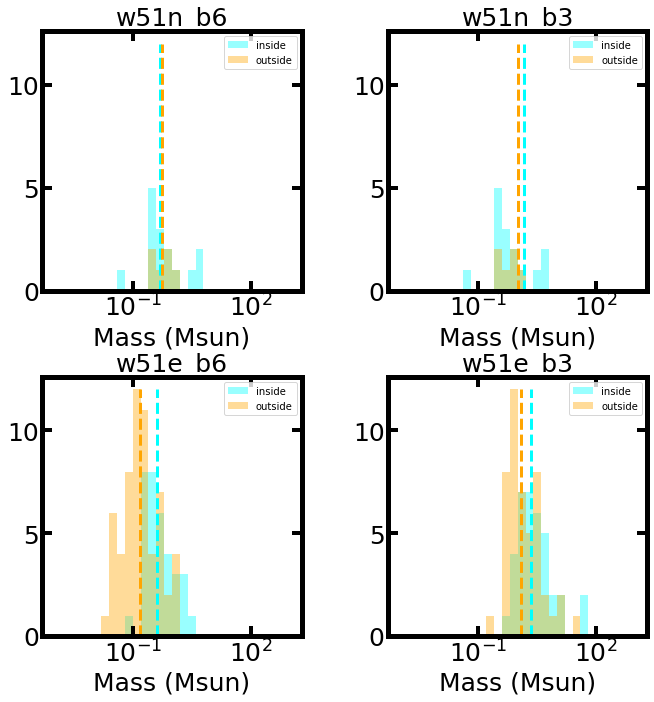

In [14]:
massbins = np.logspace(-3,3,31)
b3freq = 92982346121.91989*u.Hz
b6freq = 226691598706.70853*u.Hz
b3kappa = kappa(b3freq)
b6kappa = kappa(b6freq)
w51e_b6_mass_isincore = get_mass(w51e_b6_flux_isincore[w51e_b6_flux_isincore>0], b6kappa,  b6freq)   
w51e_b6_mass_isoutcore = get_mass(w51e_b6_flux_isoutcore[w51e_b6_flux_isoutcore>0], b6kappa,  b6freq)   

w51e_b3_mass_isincore = get_mass(w51e_b3_flux_isincore[w51e_b3_flux_isincore>0], b3kappa,  b3freq)   
w51e_b3_mass_isoutcore = get_mass(w51e_b3_flux_isoutcore[w51e_b3_flux_isoutcore>0], b3kappa,  b3freq) 

w51n_b6_mass_isincore = get_mass(w51n_b6_flux_isincore[w51n_b6_flux_isincore>0], b6kappa,  b6freq,dist=5.1*u.kpc)   
w51n_b6_mass_isoutcore = get_mass(w51n_b6_flux_isoutcore[w51n_b6_flux_isoutcore>0], b6kappa,  b6freq,dist=5.1*u.kpc)   

w51n_b3_mass_isincore = get_mass(w51n_b3_flux_isincore[w51n_b3_flux_isincore>0], b3kappa,  b3freq,dist=5.1*u.kpc)   
w51n_b3_mass_isoutcore = get_mass(w51n_b3_flux_isoutcore[w51n_b3_flux_isoutcore>0], b3kappa,  b3freq,dist=5.1*u.kpc) 

fig = plt.figure(figsize=(12,12))
ax1 = fig.add_axes([0.1,0.1,0.3,0.3])
ax2 = fig.add_axes([0.5,0.1,0.3,0.3])
ax3 = fig.add_axes([0.1,0.5,0.3,0.3])
ax4 = fig.add_axes([0.5,0.5,0.3,0.3])
ax1.hist(w51e_b6_mass_isincore.value, bins=massbins, label='inside', color='cyan', alpha=0.4)
ax1.hist(w51e_b6_mass_isoutcore.value, bins=massbins, label='outside', color='orange', alpha=0.4)
ax1.vlines(np.median(w51e_b6_mass_isincore.value),0,12, color='cyan',lw=3, ls='dashed')
ax1.vlines(np.median(w51e_b6_mass_isoutcore.value),0,12, color='orange',lw=3, ls='dashed')
ax2.hist(w51e_b3_mass_isincore.value, bins=massbins, label='inside', color='cyan', alpha=0.4)
ax2.hist(w51e_b3_mass_isoutcore.value, bins=massbins, label='outside', color='orange', alpha=0.4)
ax2.vlines(np.median(w51e_b3_mass_isincore.value),0,12, color='cyan',lw=3, ls='dashed')
ax2.vlines(np.median(w51e_b3_mass_isoutcore.value),0,12, color='orange',lw=3, ls='dashed')
ax3.hist(w51n_b6_mass_isincore.value, bins=massbins, label='inside', color='cyan', alpha=0.4)
ax3.hist(w51n_b6_mass_isoutcore.value, bins=massbins, label='outside', color='orange', alpha=0.4)
ax3.vlines(np.median(w51n_b6_mass_isincore.value),0,12, color='cyan',lw=3, ls='dashed')
ax3.vlines(np.median(w51n_b6_mass_isoutcore.value),0,12, color='orange',lw=3, ls='dashed')
ax4.hist(w51n_b6_mass_isincore.value, bins=massbins, label='inside', color='cyan', alpha=0.4)
ax4.hist(w51n_b6_mass_isoutcore.value, bins=massbins, label='outside', color='orange', alpha=0.4)
ax4.vlines(np.median(w51n_b3_mass_isincore.value),0,12, color='cyan',lw=3, ls='dashed')
ax4.vlines(np.median(w51n_b3_mass_isoutcore.value),0,12, color='orange',lw=3, ls='dashed')

ax1.set_xlabel('Mass (Msun)')
ax2.set_xlabel('Mass (Msun)')
ax3.set_xlabel('Mass (Msun)')
ax4.set_xlabel('Mass (Msun)')
ax1.set_title('w51e_b6')
ax2.set_title('w51e_b3')
ax3.set_title('w51n_b6')
ax4.set_title('w51n_b3')

ax1.set_xscale('log')
ax2.set_xscale('log')
ax3.set_xscale('log')
ax4.set_xscale('log')
ax1.legend()
ax2.legend()
ax3.legend()
ax4.legend()

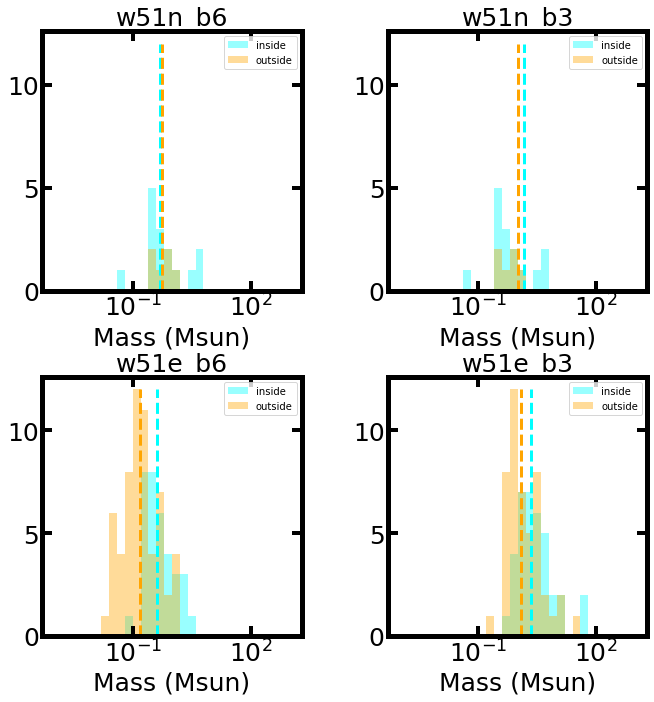

In [15]:
massbins = np.logspace(-3,3,31)
b3freq = 92982346121.91989*u.Hz
b6freq = 226691598706.70853*u.Hz
b3kappa = kappa(b3freq)
b6kappa = kappa(b6freq)
w51e_b6_mass_isincore = get_mass(w51e_b6_flux_isincore[w51e_b6_flux_isincore>0], b6kappa,  b6freq)   
w51e_b6_mass_isoutcore = get_mass(w51e_b6_flux_isoutcore[w51e_b6_flux_isoutcore>0], b6kappa,  b6freq)   

w51e_b3_mass_isincore = get_mass(w51e_b3_flux_isincore[w51e_b3_flux_isincore>0], b3kappa,  b3freq)   
w51e_b3_mass_isoutcore = get_mass(w51e_b3_flux_isoutcore[w51e_b3_flux_isoutcore>0], b3kappa,  b3freq) 

w51n_b6_mass_isincore = get_mass(w51n_b6_flux_isincore[w51n_b6_flux_isincore>0], b6kappa,  b6freq,dist=5.1*u.kpc)   
w51n_b6_mass_isoutcore = get_mass(w51n_b6_flux_isoutcore[w51n_b6_flux_isoutcore>0], b6kappa,  b6freq,dist=5.1*u.kpc)   

w51n_b3_mass_isincore = get_mass(w51n_b3_flux_isincore[w51n_b3_flux_isincore>0], b3kappa,  b3freq,dist=5.1*u.kpc)   
w51n_b3_mass_isoutcore = get_mass(w51n_b3_flux_isoutcore[w51n_b3_flux_isoutcore>0], b3kappa,  b3freq,dist=5.1*u.kpc) 

fig = plt.figure(figsize=(12,12))
ax1 = fig.add_axes([0.1,0.1,0.3,0.3])
ax2 = fig.add_axes([0.5,0.1,0.3,0.3])
ax3 = fig.add_axes([0.1,0.5,0.3,0.3])
ax4 = fig.add_axes([0.5,0.5,0.3,0.3])
ax1.hist(w51e_b6_mass_isincore.value, bins=massbins, label='inside', color='cyan', alpha=0.4)
ax1.hist(w51e_b6_mass_isoutcore.value, bins=massbins, label='outside', color='orange', alpha=0.4)
ax1.vlines(np.median(w51e_b6_mass_isincore.value),0,12, color='cyan',lw=3, ls='dashed')
ax1.vlines(np.median(w51e_b6_mass_isoutcore.value),0,12, color='orange',lw=3, ls='dashed')
ax2.hist(w51e_b3_mass_isincore.value, bins=massbins, label='inside', color='cyan', alpha=0.4)
ax2.hist(w51e_b3_mass_isoutcore.value, bins=massbins, label='outside', color='orange', alpha=0.4)
ax2.vlines(np.median(w51e_b3_mass_isincore.value),0,12, color='cyan',lw=3, ls='dashed')
ax2.vlines(np.median(w51e_b3_mass_isoutcore.value),0,12, color='orange',lw=3, ls='dashed')
ax3.hist(w51n_b6_mass_isincore.value, bins=massbins, label='inside', color='cyan', alpha=0.4)
ax3.hist(w51n_b6_mass_isoutcore.value, bins=massbins, label='outside', color='orange', alpha=0.4)
ax3.vlines(np.median(w51n_b6_mass_isincore.value),0,12, color='cyan',lw=3, ls='dashed')
ax3.vlines(np.median(w51n_b6_mass_isoutcore.value),0,12, color='orange',lw=3, ls='dashed')
ax4.hist(w51n_b6_mass_isincore.value, bins=massbins, label='inside', color='cyan', alpha=0.4)
ax4.hist(w51n_b6_mass_isoutcore.value, bins=massbins, label='outside', color='orange', alpha=0.4)
ax4.vlines(np.median(w51n_b3_mass_isincore.value),0,12, color='cyan',lw=3, ls='dashed')
ax4.vlines(np.median(w51n_b3_mass_isoutcore.value),0,12, color='orange',lw=3, ls='dashed')

ax1.set_xlabel('Mass (Msun)')
ax2.set_xlabel('Mass (Msun)')
ax3.set_xlabel('Mass (Msun)')
ax4.set_xlabel('Mass (Msun)')
ax1.set_title('w51e_b6')
ax2.set_title('w51e_b3')
ax3.set_title('w51n_b6')
ax4.set_title('w51n_b3')

ax1.set_xscale('log')
ax2.set_xscale('log')
ax3.set_xscale('log')
ax4.set_xscale('log')
ax1.legend()
ax2.legend()
ax3.legend()
ax4.legend()

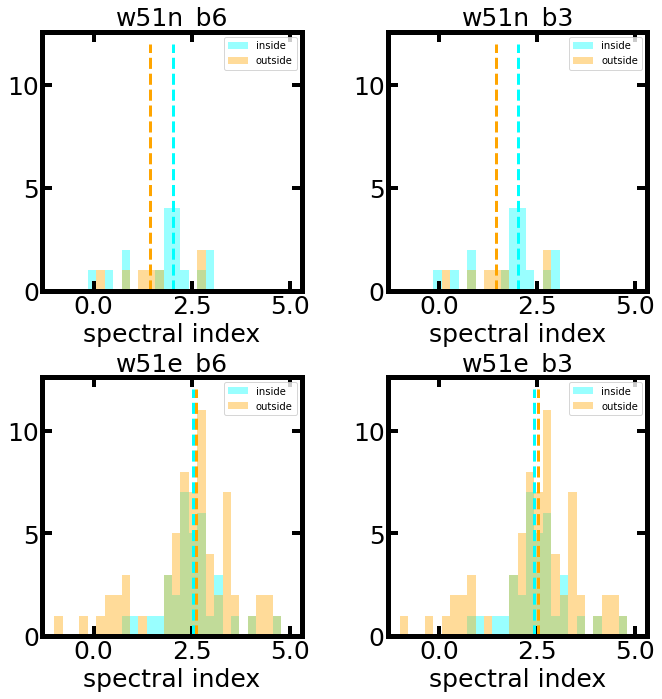

In [16]:
bins = np.linspace(-1,5,29)
fig = plt.figure(figsize=(12,12))
ax1 = fig.add_axes([0.1,0.1,0.3,0.3])
ax2 = fig.add_axes([0.5,0.1,0.3,0.3])
ax3 = fig.add_axes([0.1,0.5,0.3,0.3])
ax4 = fig.add_axes([0.5,0.5,0.3,0.3])
ax1.hist(si_w51e[isincore_w51e_b6], bins=bins, label='inside', color='cyan', alpha=0.4)
ax1.hist(si_w51e[isoutcore_w51e_b6], bins=bins, label='outside', color='orange', alpha=0.4)
ax1.vlines(np.median(si_w51e[isincore_w51e_b6]),0,12, color='cyan',lw=3, ls='dashed')
ax1.vlines(np.median(si_w51e[isoutcore_w51e_b6]),0,12, color='orange',lw=3, ls='dashed')
ax2.hist(si_w51e[isincore_w51e_b3], bins=bins, label='inside', color='cyan', alpha=0.4)
ax2.hist(si_w51e[isoutcore_w51e_b3], bins=bins, label='outside', color='orange', alpha=0.4)
ax2.vlines(np.median(si_w51e[isincore_w51e_b3]),0,12, color='cyan',lw=3, ls='dashed')
ax2.vlines(np.median(si_w51e[isoutcore_w51e_b3]),0,12, color='orange',lw=3, ls='dashed')
ax3.hist(si_w51n[isincore_w51n_b6], bins=bins, label='inside', color='cyan', alpha=0.4)
ax3.hist(si_w51n[isoutcore_w51n_b6], bins=bins, label='outside', color='orange', alpha=0.4)
ax3.vlines(np.median(si_w51n[isincore_w51n_b6]),0,12, color='cyan',lw=3, ls='dashed')
ax3.vlines(np.median(si_w51n[isoutcore_w51n_b6]),0,12, color='orange',lw=3, ls='dashed')
ax4.hist(si_w51n[isincore_w51n_b6], bins=bins, label='inside', color='cyan', alpha=0.4)
ax4.hist(si_w51n[isoutcore_w51n_b6], bins=bins, label='outside', color='orange', alpha=0.4)
ax4.vlines(np.median(si_w51n[isincore_w51n_b6]),0,12, color='cyan',lw=3, ls='dashed')
ax4.vlines(np.median(si_w51n[isoutcore_w51n_b6]),0,12, color='orange',lw=3, ls='dashed')

ax1.set_xlabel('spectral index')
ax2.set_xlabel('spectral index')
ax3.set_xlabel('spectral index')
ax4.set_xlabel('spectral index')
ax1.set_title('w51e_b6')
ax2.set_title('w51e_b3')
ax3.set_title('w51n_b6')
ax4.set_title('w51n_b3')

#ax1.set_xscale('log')
#ax2.set_xscale('log')
#ax3.set_xscale('log')
#ax4.set_xscale('log')
ax1.legend()
ax2.legend()
ax3.legend()
ax4.legend()

ho [242.06042433   0.           0.         288.84143447 378.63635847
 165.52627552 253.110919   226.01656071   0.         331.97149053
 139.08139693 473.72466366 117.18173995   0.           0.
 229.45176329 202.72523655 156.46437884 127.97909755 252.27268556
 170.15478653 184.34238329 219.23921535 158.23521489 327.94718933
 176.19294065 215.23873596 201.37938764   0.           0.
          nan 193.19861293 236.28060428 409.5704718  136.08323995]
hoho [141.0063342  190.23702641   0.           0.           0.
 154.5071158  174.8877421  213.40577189   0.         262.68835844
   0.         223.52444133 165.2568702    0.         163.36585383
 244.24966825 221.88655988 149.49526369   0.         490.01820593
 114.66389626 364.11518215   0.         134.26410021 166.26831441
 140.85315546 200.93110543   0.           0.           0.
   0.                  nan          nan          nan          nan
          nan          nan          nan          nan          nan
          nan   0.         115.75

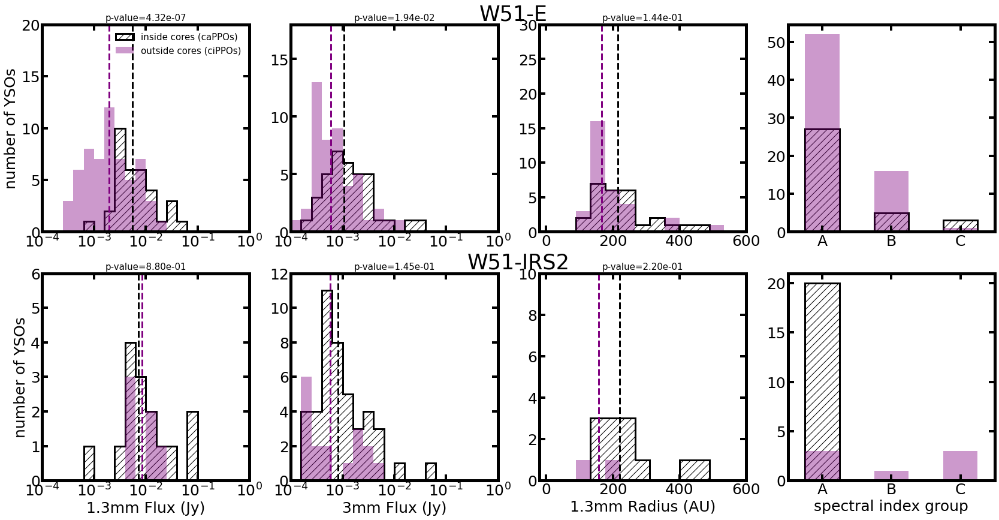

In [17]:
import seaborn as sns
from scipy import stats

fig = plt.figure(figsize=(24,12))
ax5 = fig.add_axes([0.05,0.08,0.2,0.4])
ax6 = fig.add_axes([0.29,0.08,0.2,0.4])
ax7 = fig.add_axes([0.53,0.08,0.2,0.4])
ax8 = fig.add_axes([0.77,0.08,0.2,0.4])

ax1 = fig.add_axes([0.05,0.56,0.2,0.4])
ax2 = fig.add_axes([0.29,0.56,0.2,0.4])
ax3 = fig.add_axes([0.53,0.56,0.2,0.4])
ax4 = fig.add_axes([0.77,0.56,0.2,0.4])


bins = np.logspace(-4,0,21)
#plt.subtitle('W51-E')
plt.figtext(0.51, 0.5, 'W51-IRS2', ha='center', va='center',fontsize=35)
plt.figtext(0.505, 0.98, 'W51-E', ha='center', va='center',fontsize=35)


ax1.hist(w51e_b6_flux_isincore[w51e_b6_flux_isincore>0], histtype='stepfilled', facecolor='none',bins=bins, label='inside cores (caPPOs)',edgecolor='k',lw=3,hatch='//')
ax1.hist(w51e_b6_flux_isoutcore[w51e_b6_flux_isoutcore>0], bins=bins, label='outside cores (ciPPOs)', color='purple', alpha=0.4)
ax1.vlines(np.median(w51e_b6_flux_isincore[w51e_b6_flux_isincore>0]),0,40, color='k',lw=3, ls='dashed')
ax1.vlines(np.median(w51e_b6_flux_isoutcore[w51e_b6_flux_isoutcore>0]),0,40, color='purple',lw=3, ls='dashed')

#ax1.set_title('W51e_b6')
ax1.set_xticks([1e-4,1e-3,1e-2,1e-1,1])
ax5.set_xlabel('1.3mm Flux (Jy)')
ax1.set_yticks([0,5,10,15,20])
ax1.set_ylabel('number of YSOs')
ax1.legend(fontsize=15, frameon=False)
ax1.set_xscale('log')


ax5.hist(w51n_b6_flux_isincore[w51n_b6_flux_isincore>0], histtype='stepfilled', facecolor='none',bins=bins, label='inside cores (caPPOs)', edgecolor='k',lw=3,hatch='//')
ax5.hist(w51n_b6_flux_isoutcore[w51n_b6_flux_isoutcore>0], bins=bins, label='outside', color='purple', alpha=0.4)
ax5.vlines(np.median(w51n_b6_flux_isincore[w51n_b6_flux_isincore>0]),0,40, color='k',lw=3, ls='dashed')
ax5.vlines(np.median(w51n_b6_flux_isoutcore[w51n_b6_flux_isoutcore>0]),0,40, color='purple',lw=3, ls='dashed')
ax5.set_xticks([1e-4,1e-3,1e-2,1e-1,1])

#ax5.set_title('w51n_b6')
#ax5.set_xlabel('1.3mm Flux (Jy)')
ax5.set_ylabel('number of YSOs')
#ax5.legend(fontsize=15)
ax5.set_xscale('log')


ax2.hist(w51e_b3_flux_isincore[w51e_b3_flux_isincore>0], histtype='stepfilled', facecolor='none',bins=bins, label='inside cores (caPPOs)', edgecolor='k',lw=3,hatch='//')
ax2.hist(w51e_b3_flux_isoutcore[w51e_b3_flux_isoutcore>0], bins=bins, label='outside', color='purple', alpha=0.4)
ax2.vlines(np.median(w51e_b3_flux_isincore[w51e_b3_flux_isincore>0]),0,40, color='k',lw=3, ls='dashed')
ax2.vlines(np.median(w51e_b3_flux_isoutcore[w51e_b3_flux_isoutcore>0]),0,40, color='purple',lw=3, ls='dashed')
ax2.set_yticks([0,5,10,15])
#ax2.set_title('w51e_b3')
ax6.set_xlabel('3mm Flux (Jy)')
#ax2.set_ylabel('YSO number')
#ax2.legend(fontsize=15)
ax2.set_xscale('log')
ax2.set_xticks([1e-4,1e-3,1e-2,1e-1,1])

ax1.set_xticks([1e-4,1e-3,1e-2,1e-1,1])

ax6.hist(w51n_b3_flux_isincore[w51n_b3_flux_isincore>0], histtype='stepfilled', facecolor='none',bins=bins, label='inside cores (caPPOs)', edgecolor='k',lw=3,hatch='//')
ax6.hist(w51n_b3_flux_isoutcore[w51n_b3_flux_isoutcore>0], bins=bins, label='outside', color='purple', alpha=0.4)
ax6.vlines(np.median(w51n_b3_flux_isincore[w51n_b3_flux_isincore>0]),0,40, color='k',lw=3, ls='dashed')
ax6.vlines(np.median(w51n_b3_flux_isoutcore[w51n_b3_flux_isoutcore>0]),0,40, color='purple',lw=3, ls='dashed')
#ax4.set_title('w51n_b3')
#ax6.set_xlabel('3mm Flux (Jy)')
#ax4.set_ylabel('YSO number')
#ax4.legend(fontsize=15)
ax6.set_xscale('log')
ax6.set_xticks([1e-4,1e-3,1e-2,1e-1,1])
ax5.set_xticks([1e-4,1e-3,1e-2,1e-1,1])

bins = np.linspace(0,800,19)
print('ho',w51e_b6_rad_isincore)
print('hoho',w51e_b6_rad_isoutcore)

ax3.hist(w51e_b6_rad_isincore[w51e_b6_rad_isincore>0], bins=bins, histtype='stepfilled', facecolor='none', label='inside cores (caPPOs)', edgecolor='k',lw=3,hatch='//')
ax3.hist(w51e_b6_rad_isoutcore[w51e_b6_rad_isoutcore>0], bins=bins, label='outside', color='purple', alpha=0.4)
ax3.vlines(np.median(w51e_b6_rad_isincore[w51e_b6_rad_isincore>0]),0,40, color='k',lw=3, ls='dashed')
w51e_b6_rad_isoutcore_finite = w51e_b6_rad_isoutcore[np.isfinite(w51e_b6_rad_isoutcore)]
ax3.vlines(np.median(w51e_b6_rad_isoutcore_finite[w51e_b6_rad_isoutcore_finite>0]),0,40, color='purple',lw=3, ls='dashed')
print(np.median(w51e_b6_rad_isincore[w51e_b6_rad_isincore>0]))
print(np.median(w51e_b6_rad_isoutcore[w51e_b6_rad_isoutcore>0]))
#w51e_b6_rad_isoutcore[(w51e_b6_rad_isoutcore<1e5) & (np.isfinite(w51e_b6_rad_isoutcore))].pprint()
#ax3.set_title('W51-E 1.3mm')
#ax3.set_ylabel('YSO number')
#ax1.legend(fontsize=15)
bins = np.linspace(0,800,19)

ax7.hist(w51n_b6_rad_isincore[w51n_b6_rad_isincore>0], histtype='stepfilled', facecolor='none',bins=bins, label='inside cores (caPPOs)', edgecolor='k',lw=3,hatch='//')
ax7.hist(w51n_b6_rad_isoutcore[w51n_b6_rad_isoutcore>0], bins=bins, label='outside', color='purple', alpha=0.4)
ax7.vlines(np.median(w51n_b6_rad_isincore[w51n_b6_rad_isincore>0]),0,45, color='k',lw=3, ls='dashed')
ax7.vlines(np.median(w51n_b6_rad_isoutcore[w51n_b6_rad_isoutcore>0]),0,45, color='purple',lw=3, ls='dashed')
#ax7.set_title('W51-IRS2 1.3mm')
#ax7.set_xlabel('1.3mm Radius (AU)')
#ax7.set_ylabel('YSO number')
ax7.set_xlabel('1.3mm Radius (AU)')

bins = np.linspace(-1,5,13)
si_w51e_incore = si_w51e[isincore_w51e_b6]
si_w51e_outcore = si_w51e[isoutcore_w51e_b6]
si_w51n_incore = si_w51n[isincore_w51n_b6]
si_w51n_outcore = si_w51n[isoutcore_w51n_b6]


group_w51e = catalog_w51e_yso['group']
group_w51n = catalog_w51n_yso['group']
group_w51e_incore = group_w51e[isincore_w51e_b6]
group_w51e_outcore = group_w51e[isoutcore_w51e_b6]
group_w51n_incore = group_w51n[isincore_w51n_b6]
group_w51n_outcore = group_w51n[isoutcore_w51n_b6]
group_w51n_ffcore = group_w51n[iscore_ff_w51n]
group_w51e_ffcore = group_w51e[iscore_ff_w51e]

cmap = sns.color_palette("colorblind")
"""
ax4.hist(si_w51e_incore[group_w51e_incore==0], bins=bins, label=r'inside cores (caPPOs) (group A)', color='cyan', alpha=0.4)
ax4.hist(si_w51e_outcore[group_w51e_outcore==0], bins=bins, label=r'outside cores (ciPPOs) (group A)', color='orange', alpha=0.4)
ax4.hist(si_w51e_incore[group_w51e_incore==2], bins=bins,  label=r'inside cores (caPPOs) (group C)',facecolor='none',edgecolor=cmap[0], histtype='step', alpha=0.8,lw=5,hatch='//')
ax4.hist(si_w51e_outcore[group_w51e_outcore==2], bins=bins,  label=r'outside cores (ciPPOs) (group C)',facecolor='none',edgecolor=cmap[1], histtype='step', alpha=0.8,lw=5)
#ax4.vlines(np.median(si_w51e[isincore_w51e_b6]),0,14, color='cyan',lw=3, ls='dashed')
#ax4.vlines(np.median(si_w51e[isoutcore_w51e_b6]),0,14, color='orange',lw=3, ls='dashed')

ax8.hist(si_w51n_incore[group_w51n_incore==0], bins=bins, label='inside', color='cyan', alpha=0.4)
ax8.hist(si_w51n_outcore[group_w51n_outcore==0], bins=bins, label='outside', color='orange', alpha=0.4)
ax8.hist(si_w51n_incore[group_w51n_incore==2], bins=bins,  facecolor='none',edgecolor=cmap[0], histtype='step', alpha=0.8,lw=5,hatch='//')
ax8.hist(si_w51n_outcore[group_w51n_outcore==2], bins=bins,  facecolor='none',edgecolor=cmap[1], histtype='step', alpha=0.8,lw=5)
#ax8.vlines(np.median(si_w51n[isincore_w51n_b6]),0,5, color='cyan',lw=3, ls='dashed')
#ax8.vlines(np.median(si_w51n[isoutcore_w51n_b6]),0,5, color='orange',lw=3, ls='dashed')
"""
ax4.hist(group_w51e_incore, histtype='stepfilled', facecolor='none',bins=bins, label='inside cores (caPPOs)', edgecolor='k',lw=3,align='left',hatch='//')
ax4.hist(group_w51e_outcore, bins=bins, label=r'outside cores (ciPPOs)', color='purple', alpha=0.4, align='left')
ax8.hist(group_w51n_incore, histtype='stepfilled', facecolor='none',bins=bins, label='inside cores (caPPOs)', edgecolor='k',lw=3, align='left',hatch='//')
ax8.hist(group_w51n_outcore, bins=bins, label=r'outside cores (ciPPOs)', color='purple', alpha=0.4, align='left')
print(np.histogram(group_w51e_incore, bins=[0,1,2,3]))
print(np.histogram(group_w51e_outcore, bins=[0,1,2,3]))
print(np.histogram(group_w51n_incore, bins=[0,1,2,3]))
print(np.histogram(group_w51n_outcore, bins=[0,1,2,3]))


ax1.set_title('p-value=%3.2e'%stats.ks_2samp(w51e_b6_flux_isincore[w51e_b6_flux_isincore>0], w51e_b6_flux_isoutcore[w51e_b6_flux_isoutcore>0]).pvalue, fontsize=15)
ax2.set_title('p-value=%3.2e'%stats.ks_2samp(w51e_b3_flux_isincore[w51e_b3_flux_isincore>0], w51e_b3_flux_isoutcore[w51e_b3_flux_isoutcore>0]).pvalue, fontsize=15)
ax3.set_title('p-value=%3.2e'%stats.ks_2samp(w51e_b6_rad_isincore[w51e_b6_rad_isincore>0], w51e_b6_rad_isoutcore[w51e_b6_rad_isoutcore>0]).pvalue, fontsize=15)
#ax4.text(1.5,50,'p-value=%3.2e'%stats.ks_2samp(group_w51e_incore, group_w51e_outcore).pvalue, fontsize=15)
ax5.set_title('p-value=%3.2e'%stats.ks_2samp(w51n_b6_flux_isincore[w51n_b6_flux_isincore>0], w51n_b6_flux_isoutcore[w51n_b6_flux_isoutcore>0]).pvalue, fontsize=15)
ax6.set_title('p-value=%3.2e'%stats.ks_2samp(w51n_b3_flux_isincore[w51n_b3_flux_isincore>0], w51n_b3_flux_isoutcore[w51n_b3_flux_isoutcore>0]).pvalue, fontsize=15)
ax7.set_title('p-value=%3.2e'%stats.ks_2samp(w51n_b6_rad_isincore[w51n_b6_rad_isincore>0], w51n_b6_rad_isoutcore[w51n_b6_rad_isoutcore>0]).pvalue, fontsize=15)
#ax8.text(1.5,11,'p-value=%3.2e'%stats.ks_2samp(group_w51n_incore, group_w51n_outcore).pvalue, fontsize=15)

intersecind = np.intersect1d(np.where(w51e_b6_flux_isoutcore<2e-3)[0], isoutcore_w51e_b6)
ax8.set_xlabel('spectral index group')
ax4.set_xticks([0,1,2],['A', 'B', 'C'])
ax8.set_xticks([0,1,2],['A', 'B', 'C'])

ax4.set_xlim(-0.5,2.5)
ax8.set_xlim(-0.5,2.5)
ax3.set_xlim(-20,600)
ax7.set_xlim(-20,600)
ax1.set_xlim(1e-4,1)
ax5.set_xlim(1e-4,1)
ax2.set_xlim(1e-4,1)
ax6.set_xlim(1e-4,1)

ax5.set_ylim(0,6)
ax1.set_ylim(0,20)
ax6.set_ylim(0,12)
ax2.set_ylim(0,18)
ax7.set_ylim(0,10)
ax3.set_ylim(0,30)
#ax8.set_xlabel('spectral index')
plt.savefig('ysocomparison.png')

(array([27,  5,  3]), array([0, 1, 2, 3]))
(array([52, 16,  1]), array([0, 1, 2, 3]))
(array([12,  0,  1]), array([0, 1, 2, 3]))
(array([20,  0,  0]), array([0, 1, 2, 3]))
(array([3, 1, 3]), array([0, 1, 2, 3]))
(array([9, 0, 1]), array([0, 1, 2, 3]))


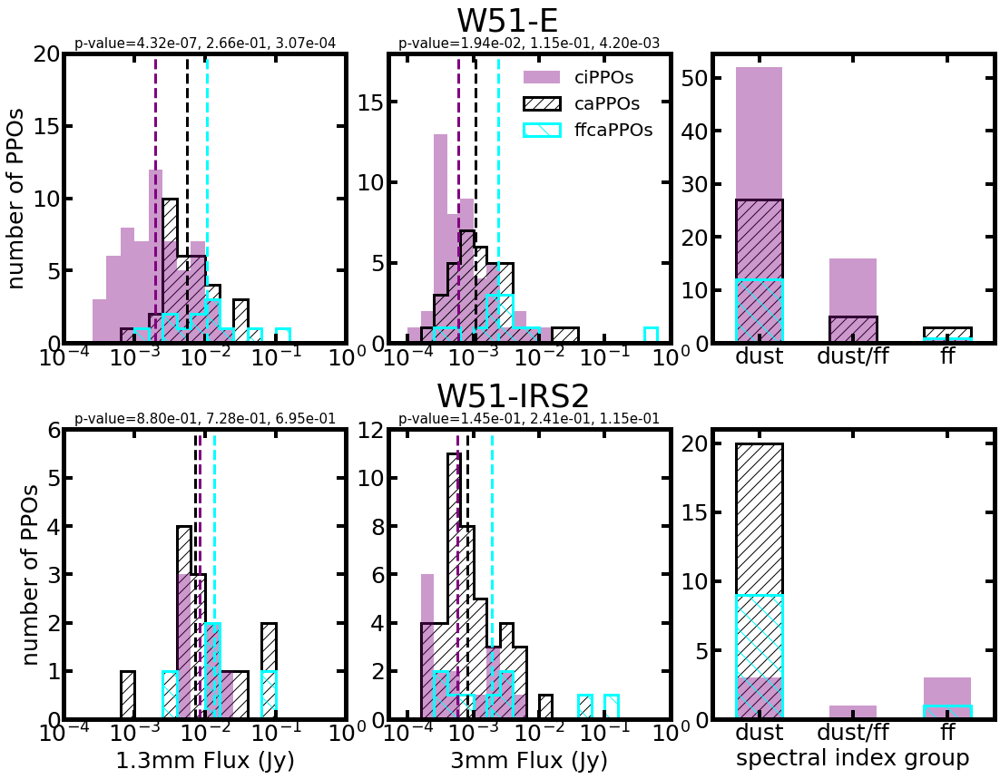

In [18]:
fig = plt.figure(figsize=(16,12))

ax5 = fig.add_axes([0.08,0.07,0.27,0.37])
ax6 = fig.add_axes([0.39,0.07,0.27,0.37])
ax8 = fig.add_axes([0.7,0.07,0.27,0.37])
ax1 = fig.add_axes([0.08,0.55,0.27,0.37])
ax2 = fig.add_axes([0.39,0.55,0.27,0.37])
ax4 = fig.add_axes([0.7,0.55,0.27,0.37])





bins = np.logspace(-4,0,21)
#plt.subtitle('W51-E')
plt.figtext(0.51, 0.48, 'W51-IRS2', ha='center', va='center',fontsize=35)
plt.figtext(0.505, 0.96, 'W51-E', ha='center', va='center',fontsize=35)
#ax2.set_title('W51-E')
#ax6.set_title('W51-IRS2')

ax1.hist(w51e_b6_flux_isincore[w51e_b6_flux_isincore>0], histtype='stepfilled', facecolor='none',bins=bins, label='inside cores (caPPOs)',edgecolor='k',lw=3,hatch='//')
ax1.hist(w51e_b6_flux_isoutcore[w51e_b6_flux_isoutcore>0], bins=bins, label='outside cores (ciPPOs)', color='purple', alpha=0.4)
ax1.hist(w51e_b6_flux_isffcore[w51e_b6_flux_isffcore>0], histtype='stepfilled', facecolor='none',bins=bins, label='PPOs associated with ff-cores',edgecolor='cyan',lw=3,hatch='\\')
ax1.vlines(np.median(w51e_b6_flux_isincore[w51e_b6_flux_isincore>0]),0,40, color='k',lw=3, ls='dashed')
ax1.vlines(np.median(w51e_b6_flux_isoutcore[w51e_b6_flux_isoutcore>0]),0,40, color='purple',lw=3, ls='dashed')
ax1.vlines(np.median(w51e_b6_flux_isffcore[w51e_b6_flux_isffcore>0]),0,40, color='cyan',lw=3, ls='dashed')
#ax1.set_title('W51e_b6')
ax1.set_xticks([1e-4,1e-3,1e-2,1e-1,1])
ax5.set_xlabel('1.3mm Flux (Jy)')
ax1.set_yticks([0,5,10,15,20])
ax1.set_ylabel('number of PPOs')
ax1.set_xscale('log')


ax5.hist(w51n_b6_flux_isincore[w51n_b6_flux_isincore>0], histtype='stepfilled', facecolor='none',bins=bins, label='inside cores (caPPOs)', edgecolor='k',lw=3,hatch='//')
ax5.hist(w51n_b6_flux_isoutcore[w51n_b6_flux_isoutcore>0], bins=bins, label='outside', color='purple', alpha=0.4)
ax5.hist(w51n_b6_flux_isffcore[w51n_b6_flux_isffcore>0], histtype='stepfilled', facecolor='none',bins=bins, label='PPOs associated with ff-cores',edgecolor='cyan',lw=3,hatch='\\')
ax5.vlines(np.median(w51n_b6_flux_isincore[w51n_b6_flux_isincore>0]),0,40, color='k',lw=3, ls='dashed')
ax5.vlines(np.median(w51n_b6_flux_isoutcore[w51n_b6_flux_isoutcore>0]),0,40, color='purple',lw=3, ls='dashed')
ax5.vlines(np.median(w51n_b6_flux_isffcore[w51n_b6_flux_isffcore>0]),0,40, color='cyan',lw=3, ls='dashed')
ax5.set_xticks([1e-4,1e-3,1e-2,1e-1,1])

#ax5.set_title('w51n_b6')
#ax5.set_xlabel('1.3mm Flux (Jy)')
ax5.set_ylabel('number of PPOs')
#ax5.legend(fontsize=15)
ax5.set_xscale('log')

ax2.hist(w51e_b3_flux_isoutcore[w51e_b3_flux_isoutcore>0], bins=bins, label='ciPPOs', color='purple', alpha=0.4)

ax2.hist(w51e_b3_flux_isincore[w51e_b3_flux_isincore>0], histtype='stepfilled', facecolor='none',bins=bins, label='caPPOs', edgecolor='k',lw=3,hatch='//')
ax2.hist(w51e_b3_flux_isffcore[w51e_b3_flux_isffcore>0], histtype='stepfilled', facecolor='none',bins=bins, label='ffcaPPOs',edgecolor='cyan',lw=3,hatch='\\')
ax2.vlines(np.median(w51e_b3_flux_isincore[w51e_b3_flux_isincore>0]),0,40, color='k',lw=3, ls='dashed')
ax2.vlines(np.median(w51e_b3_flux_isoutcore[w51e_b3_flux_isoutcore>0]),0,40, color='purple',lw=3, ls='dashed')
ax2.vlines(np.median(w51e_b3_flux_isffcore[w51e_b3_flux_isffcore>0]),0,40, color='cyan',lw=3, ls='dashed')
ax2.set_yticks([0,5,10,15])
#ax2.set_title('w51e_b3')
ax6.set_xlabel('3mm Flux (Jy)')
#ax2.set_ylabel('YSO number')
#ax2.legend(fontsize=15)
ax2.set_xscale('log')
ax2.set_xticks([1e-4,1e-3,1e-2,1e-1,1])

ax1.set_xticks([1e-4,1e-3,1e-2,1e-1,1])
ax2.legend(fontsize=20, frameon=False)

ax6.hist(w51n_b3_flux_isincore[w51n_b3_flux_isincore>0], histtype='stepfilled', facecolor='none',bins=bins, label='inside cores (caPPOs)', edgecolor='k',lw=3,hatch='//')
ax6.hist(w51n_b3_flux_isoutcore[w51n_b3_flux_isoutcore>0], bins=bins, label='outside', color='purple', alpha=0.4)
ax6.hist(w51n_b3_flux_isffcore[w51n_b3_flux_isffcore>0], histtype='stepfilled', facecolor='none',bins=bins, label='PPOs associated with ff-cores',edgecolor='cyan',lw=3,hatch='\\')
ax6.vlines(np.median(w51n_b3_flux_isincore[w51n_b3_flux_isincore>0]),0,40, color='k',lw=3, ls='dashed')
ax6.vlines(np.median(w51n_b3_flux_isoutcore[w51n_b3_flux_isoutcore>0]),0,40, color='purple',lw=3, ls='dashed')
ax6.vlines(np.median(w51n_b3_flux_isffcore[w51n_b3_flux_isffcore>0]),0,40, color='cyan',lw=3, ls='dashed')
#ax4.set_title('w51n_b3')
#ax6.set_xlabel('3mm Flux (Jy)')
#ax4.set_ylabel('YSO number')
#ax4.legend(fontsize=15)
ax6.set_xscale('log')
ax6.set_xticks([1e-4,1e-3,1e-2,1e-1,1])
ax5.set_xticks([1e-4,1e-3,1e-2,1e-1,1])




bins = np.linspace(-1,5,13)
si_w51e_incore = si_w51e[isincore_w51e_b6]
si_w51e_outcore = si_w51e[isoutcore_w51e_b6]
si_w51n_incore = si_w51n[isincore_w51n_b6]
si_w51n_outcore = si_w51n[isoutcore_w51n_b6]


group_w51e = catalog_w51e_yso['group']
group_w51n = catalog_w51n_yso['group']
group_w51e_incore = group_w51e[isincore_w51e_b6]
group_w51e_outcore = group_w51e[isoutcore_w51e_b6]
group_w51n_incore = group_w51n[isincore_w51n_b6]
group_w51n_outcore = group_w51n[isoutcore_w51n_b6]

cmap = sns.color_palette("colorblind")
"""
ax4.hist(si_w51e_incore[group_w51e_incore==0], bins=bins, label=r'inside cores (caPPOs) (group A)', color='cyan', alpha=0.4)
ax4.hist(si_w51e_outcore[group_w51e_outcore==0], bins=bins, label=r'outside cores (ciPPOs) (group A)', color='orange', alpha=0.4)
ax4.hist(si_w51e_incore[group_w51e_incore==2], bins=bins,  label=r'inside cores (caPPOs) (group C)',facecolor='none',edgecolor=cmap[0], histtype='step', alpha=0.8,lw=5,hatch='//')
ax4.hist(si_w51e_outcore[group_w51e_outcore==2], bins=bins,  label=r'outside cores (ciPPOs) (group C)',facecolor='none',edgecolor=cmap[1], histtype='step', alpha=0.8,lw=5)
#ax4.vlines(np.median(si_w51e[isincore_w51e_b6]),0,14, color='cyan',lw=3, ls='dashed')
#ax4.vlines(np.median(si_w51e[isoutcore_w51e_b6]),0,14, color='orange',lw=3, ls='dashed')

ax8.hist(si_w51n_incore[group_w51n_incore==0], bins=bins, label='inside', color='cyan', alpha=0.4)
ax8.hist(si_w51n_outcore[group_w51n_outcore==0], bins=bins, label='outside', color='orange', alpha=0.4)
ax8.hist(si_w51n_incore[group_w51n_incore==2], bins=bins,  facecolor='none',edgecolor=cmap[0], histtype='step', alpha=0.8,lw=5,hatch='//')
ax8.hist(si_w51n_outcore[group_w51n_outcore==2], bins=bins,  facecolor='none',edgecolor=cmap[1], histtype='step', alpha=0.8,lw=5)
#ax8.vlines(np.median(si_w51n[isincore_w51n_b6]),0,5, color='cyan',lw=3, ls='dashed')
#ax8.vlines(np.median(si_w51n[isoutcore_w51n_b6]),0,5, color='orange',lw=3, ls='dashed')
"""
ax4.hist(group_w51e_incore, histtype='stepfilled', facecolor='none',bins=bins, label='inside cores (caPPOs)', edgecolor='k',lw=3,align='left',hatch='//')
ax4.hist(group_w51e_outcore, bins=bins, label=r'outside cores (ciPPOs)', color='purple', alpha=0.4, align='left')
ax4.hist(group_w51e_ffcore, histtype='stepfilled', facecolor='none',bins=bins, label='PPOs associated with ff-cores', edgecolor='cyan',lw=3,align='left',hatch='\\')
ax8.hist(group_w51n_incore, histtype='stepfilled', facecolor='none',bins=bins, label='inside cores (caPPOs)', edgecolor='k',lw=3, align='left',hatch='//')
ax8.hist(group_w51n_outcore, bins=bins, label=r'outside cores (ciPPOs)', color='purple', alpha=0.4, align='left')
ax8.hist(group_w51n_ffcore, histtype='stepfilled', facecolor='none',bins=bins, label='PPOs associated with ff-cores', edgecolor='cyan',lw=3, align='left',hatch='\\')
print(np.histogram(group_w51e_incore, bins=[0,1,2,3]))
print(np.histogram(group_w51e_outcore, bins=[0,1,2,3]))
print(np.histogram(group_w51e_ffcore, bins=[0,1,2,3]))
print(np.histogram(group_w51n_incore, bins=[0,1,2,3]))
print(np.histogram(group_w51n_outcore, bins=[0,1,2,3]))
print(np.histogram(group_w51n_ffcore, bins=[0,1,2,3]))

w51e_b6_ks1 = stats.ks_2samp(w51e_b6_flux_isincore[w51e_b6_flux_isincore>0], w51e_b6_flux_isoutcore[w51e_b6_flux_isoutcore>0]).pvalue
w51e_b6_ks2 = stats.ks_2samp(w51e_b6_flux_isincore[w51e_b6_flux_isincore>0], w51e_b6_flux_isffcore[w51e_b6_flux_isffcore>0]).pvalue
w51e_b6_ks3 = stats.ks_2samp(w51e_b6_flux_isoutcore[w51e_b6_flux_isoutcore>0], w51e_b6_flux_isffcore[w51e_b6_flux_isffcore>0]).pvalue
w51e_b3_ks1 = stats.ks_2samp(w51e_b3_flux_isincore[w51e_b3_flux_isincore>0], w51e_b3_flux_isoutcore[w51e_b3_flux_isoutcore>0]).pvalue
w51e_b3_ks2 = stats.ks_2samp(w51e_b3_flux_isincore[w51e_b3_flux_isincore>0], w51e_b3_flux_isffcore[w51e_b3_flux_isffcore>0]).pvalue
w51e_b3_ks3 = stats.ks_2samp(w51e_b3_flux_isoutcore[w51e_b3_flux_isoutcore>0], w51e_b3_flux_isffcore[w51e_b3_flux_isffcore>0]).pvalue
w51n_b6_ks1 = stats.ks_2samp(w51n_b6_flux_isincore[w51n_b6_flux_isincore>0], w51n_b6_flux_isoutcore[w51n_b6_flux_isoutcore>0]).pvalue
w51n_b6_ks2 = stats.ks_2samp(w51n_b6_flux_isincore[w51n_b6_flux_isincore>0], w51n_b6_flux_isffcore[w51n_b6_flux_isffcore>0]).pvalue
w51n_b6_ks3 = stats.ks_2samp(w51n_b6_flux_isoutcore[w51n_b6_flux_isoutcore>0], w51n_b6_flux_isffcore[w51n_b6_flux_isffcore>0]).pvalue
w51n_b3_ks1 = stats.ks_2samp(w51n_b3_flux_isincore[w51n_b3_flux_isincore>0], w51n_b3_flux_isoutcore[w51n_b3_flux_isoutcore>0]).pvalue
w51n_b3_ks2 = stats.ks_2samp(w51n_b3_flux_isincore[w51n_b3_flux_isincore>0], w51n_b3_flux_isffcore[w51n_b3_flux_isffcore>0]).pvalue
w51n_b3_ks3 = stats.ks_2samp(w51n_b3_flux_isoutcore[w51n_b3_flux_isoutcore>0], w51n_b3_flux_isffcore[w51n_b3_flux_isffcore>0]).pvalue
ax1.set_title('p-value=%3.2e, %3.2e, %3.2e'%(w51e_b6_ks1,w51e_b6_ks2,w51e_b6_ks3), fontsize=15)
ax2.set_title('p-value=%3.2e, %3.2e, %3.2e'%(w51e_b3_ks1,w51e_b3_ks2,w51e_b3_ks3), fontsize=15)
#ax3.set_title('p-value=%3.2e'%stats.ks_2samp(w51e_b6_rad_isincore[w51e_b6_rad_isincore>0], w51e_b6_rad_isoutcore[w51e_b6_rad_isoutcore>0]).pvalue, fontsize=15)
#ax4.text(1.5,50,'p-value=%3.2e'%stats.ks_2samp(group_w51e_incore, group_w51e_outcore).pvalue, fontsize=15)
ax5.set_title('p-value=%3.2e, %3.2e, %3.2e'%(w51n_b6_ks1,w51n_b6_ks2,w51n_b6_ks3), fontsize=15)
ax6.set_title('p-value=%3.2e, %3.2e, %3.2e'%(w51n_b3_ks1,w51n_b3_ks2,w51n_b3_ks3), fontsize=15)
#ax7.set_title('p-value=%3.2e'%stats.ks_2samp(w51n_b6_rad_isincore[w51n_b6_rad_isincore>0], w51n_b6_rad_isoutcore[w51n_b6_rad_isoutcore>0]).pvalue, fontsize=15)
#ax8.text(1.5,11,'p-value=%3.2e'%stats.ks_2samp(group_w51n_incore, group_w51n_outcore).pvalue, fontsize=15)

intersecind = np.intersect1d(np.where(w51e_b6_flux_isoutcore<2e-3)[0], isoutcore_w51e_b6)
ax8.set_xlabel('spectral index group')
ax4.set_xticks([0,1,2],['dust', 'dust/ff', 'ff'])
ax8.set_xticks([0,1,2],['dust', 'dust/ff', 'ff'])

ax4.set_xlim(-0.5,2.5)
ax8.set_xlim(-0.5,2.5)
ax3.set_xlim(-20,600)
ax7.set_xlim(-20,600)
ax1.set_xlim(1e-4,1)
ax5.set_xlim(1e-4,1)
ax2.set_xlim(5e-5,1)
ax6.set_xlim(5e-5,1)

ax5.set_ylim(0,6)
ax1.set_ylim(0,20)
ax6.set_ylim(0,12)
ax2.set_ylim(0,18)
ax7.set_ylim(0,10)
ax3.set_ylim(0,30)
#ax8.set_xlabel('spectral index')
plt.savefig('ysocomparison.png')



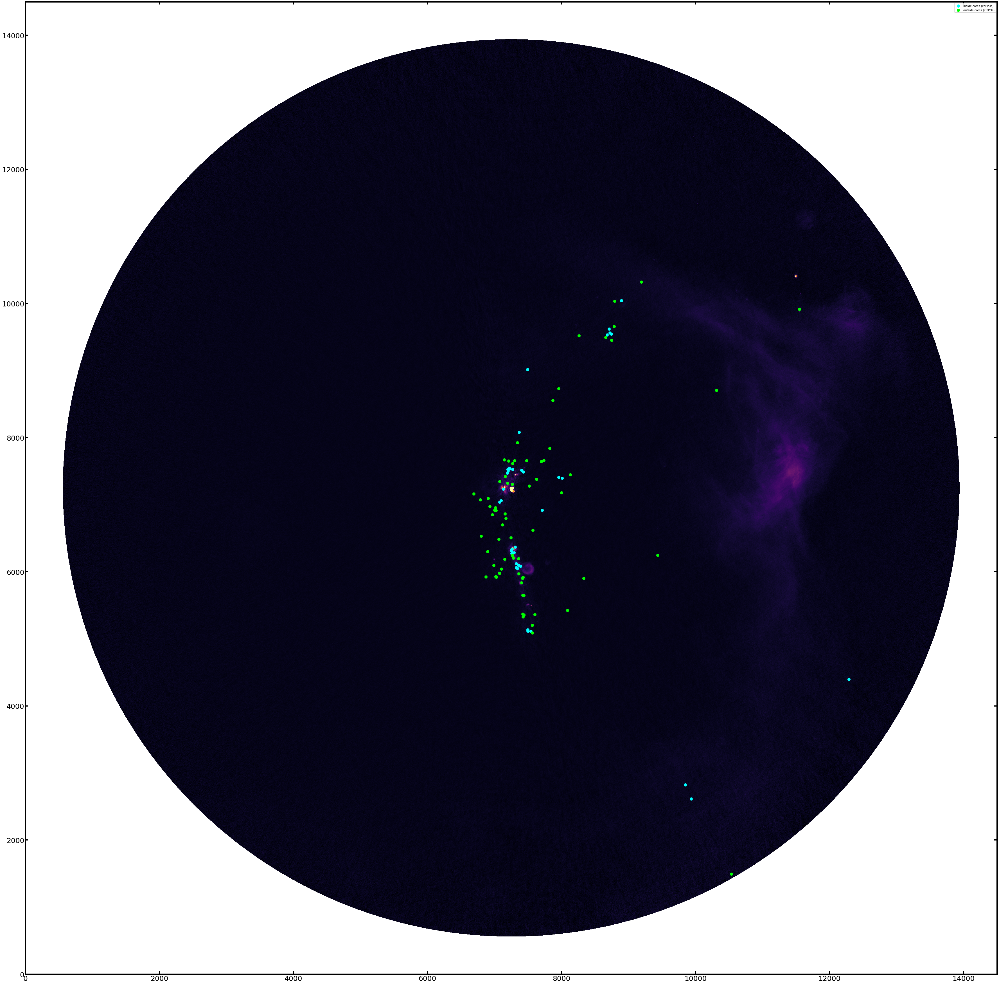

In [19]:
fitsdata_b3 = fits.open(Path.w51e_b3_tt0)
image_b3_w51e = fitsdata_b3[0].data
if len(image_b3_w51e.shape)>2:
    image_b3_w51e = fitsdata_b3[0].data[0][0]
hdrB3_w51e_hr = fits.getheader(Path.w51e_b3_tt0)  

wcsB3_w51e_hr = WCS(hdrB3_w51e_hr,naxis=2)
fig = plt.figure(figsize=(60,60))
ax1 = fig.add_axes([0.1,0.1,0.8,0.8])
ax1.imshow(image_b3_w51e, cmap='inferno',origin='lower', vmin=-0.000103489713773963128,vmax=0.002216252472302186)
yso_xysource_pix_w51e = wcsB3_w51e_hr.wcs_world2pix(yso_xysource_w51e,0)
yso_xysource_pix_w51n = wcsB3_w51e_hr.wcs_world2pix(yso_xysource_w51n,0)

ax1.scatter(yso_xysource_pix_w51e[isincore_w51e_b3,0], yso_xysource_pix_w51e[isincore_w51e_b3,1], color='cyan', s=100, label='inside cores (caPPOs)')
ax1.scatter(yso_xysource_pix_w51e[isoutcore_w51e_b3,0], yso_xysource_pix_w51e[isoutcore_w51e_b3,1], color='lime', s=100, label='outside cores (ciPPOs)')
ax1.legend()
plt.savefig('ysomap_w_wo_cores_w51e_b3.png')

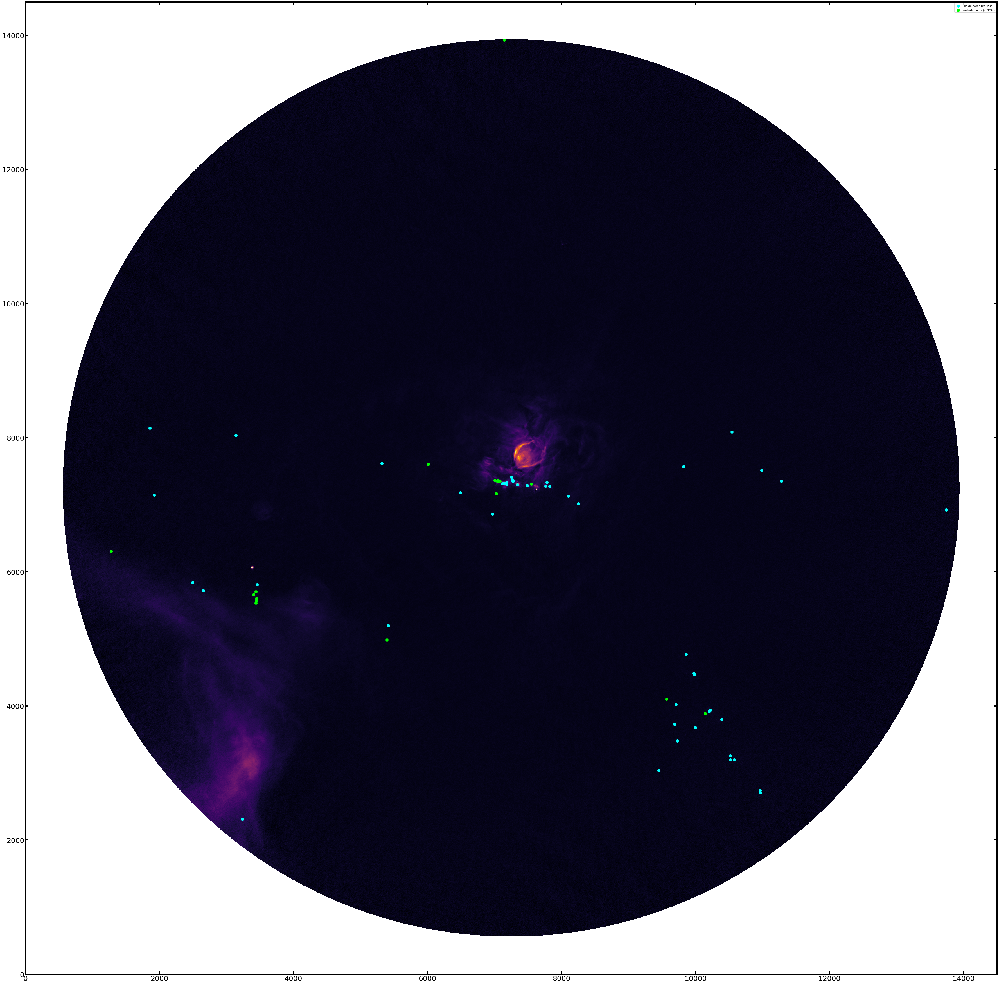

In [20]:
fitsdata_b3 = fits.open(Path.w51n_b3_tt0)
image_b3_w51n = fitsdata_b3[0].data
if len(image_b3_w51n.shape)>2:
    image_b3_w51n = fitsdata_b3[0].data[0][0]
hdrB3_w51n_hr = fits.getheader(Path.w51n_b3_tt0)  

wcsB3_w51n_hr = WCS(hdrB3_w51n_hr,naxis=2)
fig = plt.figure(figsize=(60,60))
ax1 = fig.add_axes([0.1,0.1,0.8,0.8])
ax1.imshow(image_b3_w51n, cmap='inferno',origin='lower', vmin=-0.000103489713773963128,vmax=0.002216252472302186)
yso_xysource_pix_w51e = wcsB3_w51n_hr.wcs_world2pix(yso_xysource_w51e,0)
yso_xysource_pix_w51n = wcsB3_w51n_hr.wcs_world2pix(yso_xysource_w51n,0)

ax1.scatter(yso_xysource_pix_w51n[isincore_w51n_b3,0], yso_xysource_pix_w51n[isincore_w51n_b3,1], color='cyan', s=100, label='inside cores (caPPOs)')
ax1.scatter(yso_xysource_pix_w51n[isoutcore_w51n_b3,0], yso_xysource_pix_w51n[isoutcore_w51n_b3,1], color='lime', s=100, label='outside cores (ciPPOs)')
ax1.legend()
plt.savefig('ysomap_w_wo_cores_w51n_b3.png')